In [1]:
from __future__ import print_function, division
import os
import torch
import glob 
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [3]:
folder_path = os.path.dirname("/Users/alex_christlieb/Desktop/small_sample_out/")
# image_paths = glob.glob("/Users/alex_christlieb/Desktop/small_sample_out/*.jpeg")

In [16]:
metadata = pd.read_hdf(os.path.join(folder_path, "metadata_sample.hdf"),'/d')
metadata

,building_id,image_buffer,image_provider,b_outline,b_surfaces,panel_polygons,panel_centroids
0,78a6cd53-5fe9-4a91-b328-be04817f73f1,15,C,"[[378, 112], [378, 387], [121, 387], [121, 112...","[[392, 134], [152, 404], [213, 450], [453, 180...","[[[172, 367], [154, 353], [164, 342], [182, 35...","[[168, 355], [149, 341], [178, 343], [159, 329..."
0,8724d454-483a-4e0d-8e4b-1f45666fd0c6,15,C,"[[395, 131], [395, 368], [104, 368], [104, 131...","[[[248, 335], [196, 184], [125, 223], [132, 24...","[[[142, 227], [159, 218], [164, 233], [148, 24...","[[153, 230], [170, 221], [187, 211], [176, 237..."
0,41f7159f-7cd1-45ab-87b1-1fa761ff2aba,15,C,"[[330, 130], [330, 369], [169, 369], [169, 130...","[[225, 298], [203, 424], [345, 439], [392, 171...","[[[281, 355], [246, 352], [250, 332], [284, 33...","[[265, 344], [230, 340], [195, 337], [269, 324..."
0,4df4d98d-4042-47c0-8331-1f63a5e536c7,15,C,"[[387, 145], [387, 354], [112, 354], [112, 145...","[[[260, 294], [246, 209], [165, 145], [139, 20...","[[[241, 232], [228, 259], [215, 249], [228, 22...","[[228, 240], [214, 230], [201, 219], [188, 209..."
0,71c524ac-1c82-4ba7-9731-0fc0d0f970a2,15,C,"[[329, 136], [126, 297], [171, 363], [174, 360...","[[394, 164], [152, 357], [205, 435], [209, 432...","[[[177, 353], [164, 335], [178, 323], [191, 34...","[[177, 338], [164, 319], [151, 301], [192, 327..."
...,...,...,...,...,...,...,...
0,410de536-b389-481d-a893-12b6ae7fd9e1,15,C,"[[374, 124], [374, 375], [125, 375], [125, 124...","[[[279, 254], [239, 357], [288, 375], [314, 30...","[[[287, 366], [267, 358], [273, 342], [293, 35...","[[280, 354], [260, 346], [286, 338], [266, 330..."
0,5a868e68-edd9-4d4c-8fb8-1d30b56c0f49,15,C,"[[390, 93], [390, 406], [109, 406], [109, 93],...","[[[262, 272], [266, 243], [236, 211], [227, 26...","[[[256, 268], [234, 266], [236, 254], [257, 25...","[[246, 261], [248, 248], [231, 309], [209, 307..."
0,b33e39fb-e42e-4cd6-a18b-0359f7d9fc9d,15,C,"[[322, 143], [322, 356], [177, 356], [177, 143...","[[213, 211], [254, 427], [377, 413], [336, 196...","[[[297, 336], [261, 340], [257, 321], [293, 31...","[[277, 328], [240, 333], [273, 308], [236, 313..."
0,2d5c5e72-bf4a-4e02-8768-5dd987583398,15,C,"[[333, 157], [333, 342], [166, 342], [166, 157...","[[399, 243], [275, 198], [210, 365], [331, 410...","[[[274, 329], [244, 318], [252, 299], [282, 31...","[[263, 314], [233, 303], [203, 292], [271, 294..."


In [159]:
import random as rand
list_names = []
# for i in range(20):
#     list_names.append(rand.choice(metadata.building_id.to_list()))

list_names = metadata.building_id.to_list()


In [134]:
def count_list(list_of_lists):
    if not isinstance(list_of_lists, list):
        return 0
    return max(map(count_list, list_of_lists), default=0) + 1

In [111]:
def show_centroids(image, centroids = None, surface= None, base = None, polygons = None):
    """Show image with centroids"""
    plt.figure()
    plt.imshow(image)
    plt.axis("off")
    plt.title()

    if centroids is not None:
        plt.scatter(centroids[:, 1], centroids[:, 0], s=10, marker='.', c='k')
    
    
    if base is not None:
        plt.plot(base[:, 1], base[:, 0], marker='.', c='b')

    if polygons is not None:
        for p in polygons:
            plt.plot(p[:, 1], p[:, 0], marker='.', c='r')

    if surface is not None:
        if not isinstance(surface,np.ndarray): 
            for s in surface:
                s = np.array(s)
                plt.plot(s[:, 1], s[:, 0], marker='.', c='g')
        else:
            plt.plot(surface[:, 1], surface[:, 0], marker='.', c='g')

    plt.pause(0.001)  # pause a bit so that plots are updated
    plt.show()

In [155]:
def plot_from_id(img_name):
    image_path = "/Users/alex_christlieb/Desktop/small_sample_out/"+img_name+"-b15-otovowms.jpeg"
    img_data = metadata[metadata["building_id"] == img_name]
    centroids = np.array(img_data["panel_centroids"][0]).astype('float')

    surface = (img_data["b_surfaces"][0])#list of np arrays

    if count_list(surface) == 2:
        surface = np.array(img_data["b_surfaces"][0]).astype('float')

    polygons = np.array(img_data["panel_polygons"][0]).astype('float')
    base = np.array(img_data["b_outline"][0]).astype('float')

    print(f"Image name: {img_name}")
    show_centroids(io.imread(image_path), centroids, surface = surface, base = base, polygons = polygons)
    show_centroids(io.imread(image_path), centroids)



--- 0
Image name: 78a6cd53-5fe9-4a91-b328-be04817f73f1


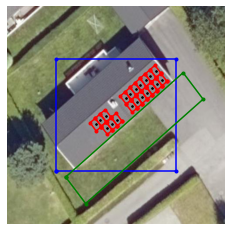

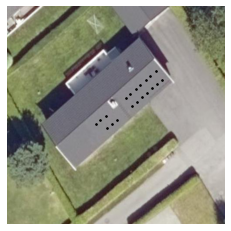

--- 1
Image name: 8724d454-483a-4e0d-8e4b-1f45666fd0c6


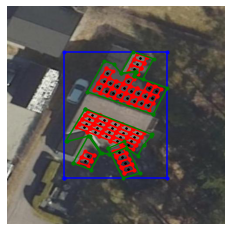

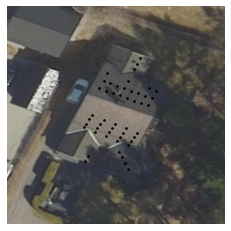

--- 2
Image name: 41f7159f-7cd1-45ab-87b1-1fa761ff2aba


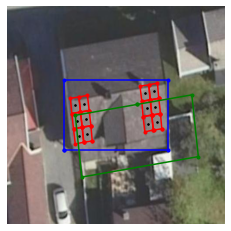

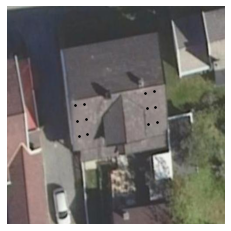

--- 3
Image name: 4df4d98d-4042-47c0-8331-1f63a5e536c7


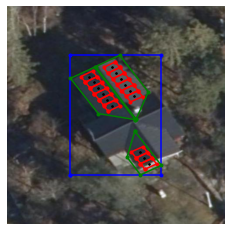

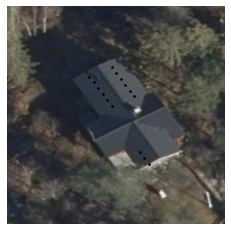

--- 4
Image name: 71c524ac-1c82-4ba7-9731-0fc0d0f970a2


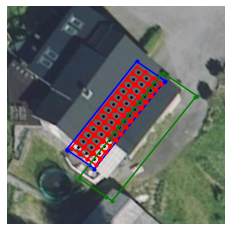

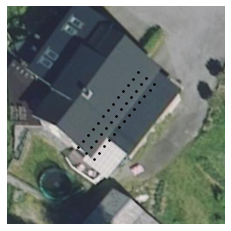

--- 5
Image name: 08c9f18c-54f0-4632-bd8b-3d9434febf69


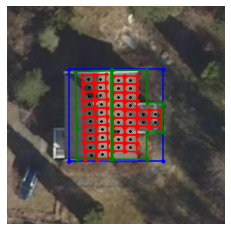

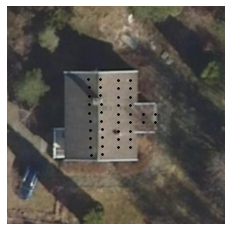

--- 6
Image name: 9534b4b0-bf42-425e-a5c6-78e08843872e


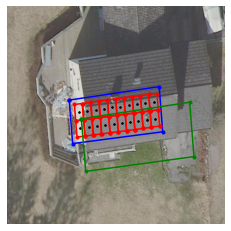

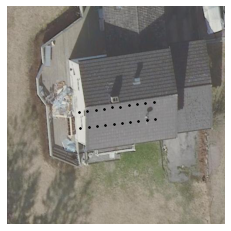

--- 7
Image name: fa1da4f4-45bc-41f7-983d-cb44949a366d


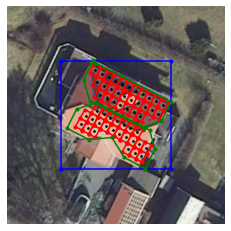

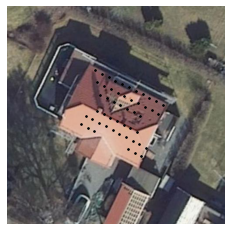

--- 8
Image name: 190654f9-2d1a-43f2-9402-30bf9bb41974


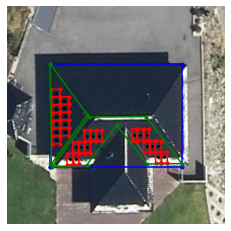

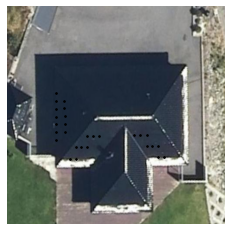

--- 9
Image name: 78d0044a-6515-4f3a-bb39-281c6b325964


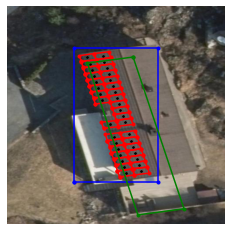

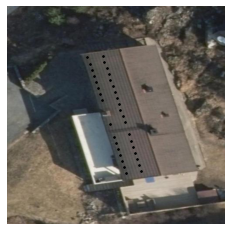

--- 10
Image name: 4ab5cc4e-031b-4b67-a659-5d9448aa0f3e


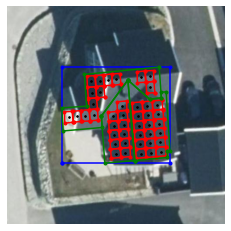

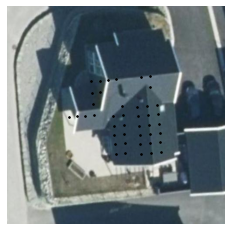

--- 11
Image name: e58bdfaf-61fb-4c4f-b931-d9c45f4c3321


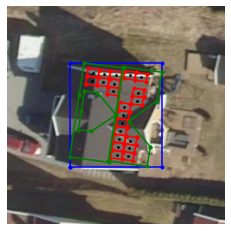

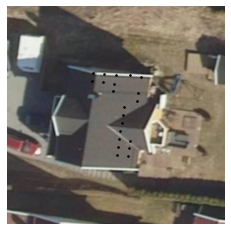

--- 12
Image name: ecc88776-6260-4dfb-a21d-0f8277cad398


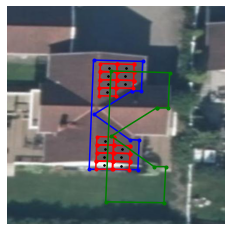

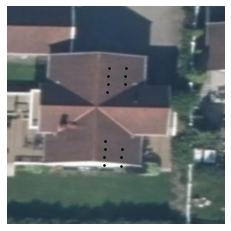

--- 13
Image name: 43187b7c-d99b-408c-9c00-26a28f562fff


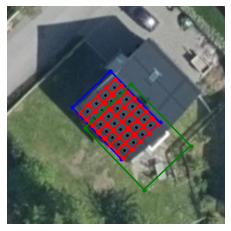

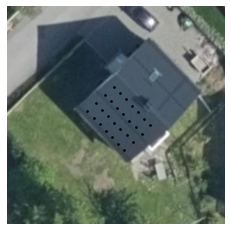

--- 14
Image name: 1a0f0a1e-5b1b-4fb5-aa14-52e8b92e99e6


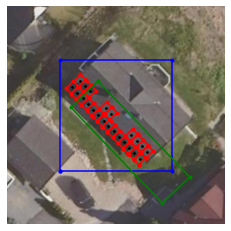

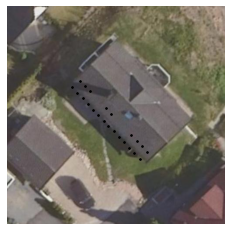

--- 15
Image name: 131d67af-6156-4388-9dcf-7a9ee6c69c8a


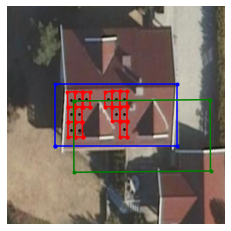

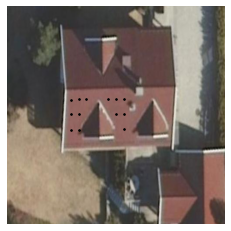

--- 16
Image name: 0e628327-90dd-4a77-ad21-b631c96ee671


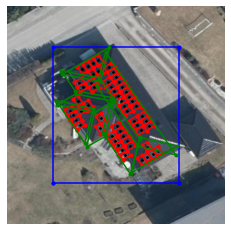

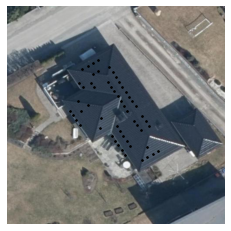

--- 17
Image name: 673a5194-66fa-41d8-b63e-49f00d2d9105


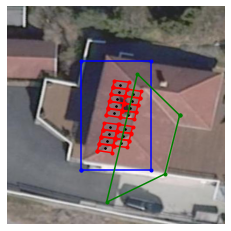

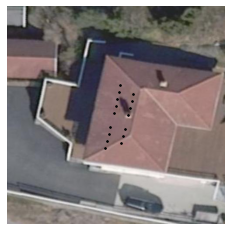

--- 18
Image name: 71204a5e-e6c7-4969-956d-507504c95955


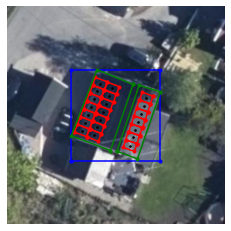

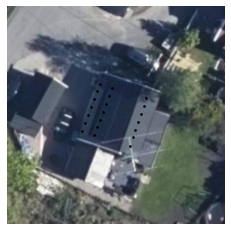

--- 19
Image name: f5484a4b-25c3-4f0c-883d-8673d8c46249


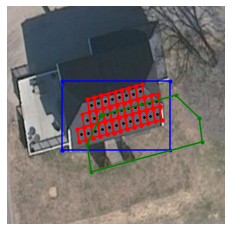

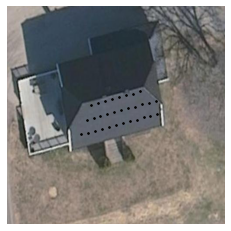

--- 20
Image name: a59bdbeb-08a8-4425-bde7-2f2253af5545


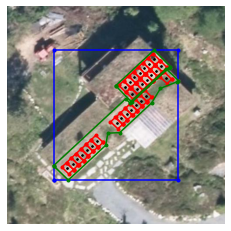

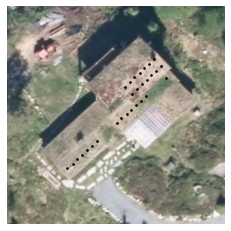

--- 21
Image name: c984058d-dcd3-47c2-bbd1-2b33be79d252


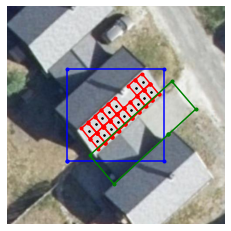

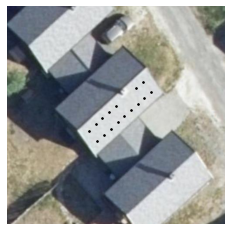

--- 22
Image name: 11aea3c0-f8e8-474c-8c53-52d5ec039747


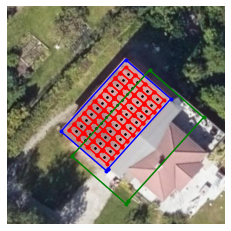

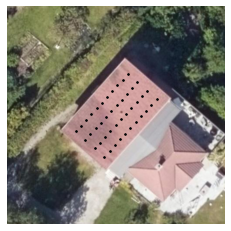

--- 23
Image name: 49f1cbaa-5800-445a-b001-4147ac7274b2


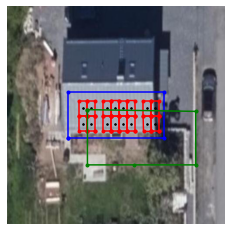

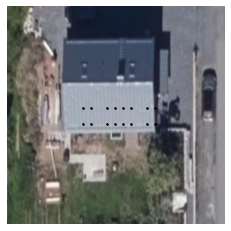

--- 24
Image name: b7e04765-5e5b-450a-86e7-545db832b0d9


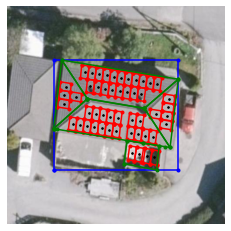

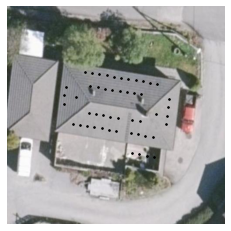

--- 25
Image name: 55eb6d44-9997-41c7-a542-5004bf579c3c


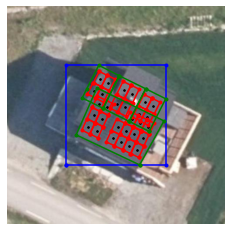

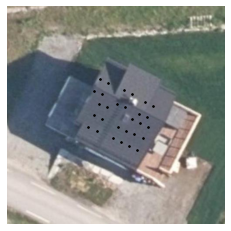

--- 26
Image name: 3186f6c5-42c9-4759-ba85-0b052b5dadfe


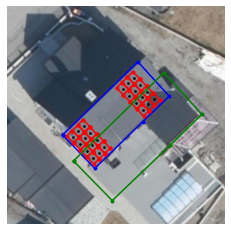

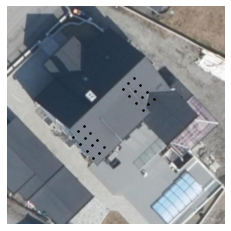

--- 27
Image name: 3cc00b88-375a-4dee-8844-351744ced5b1


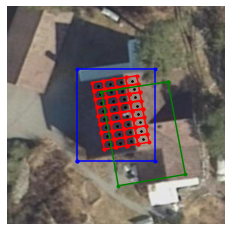

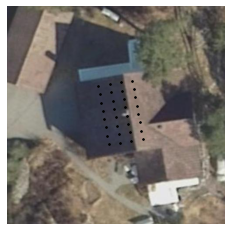

--- 28
Image name: b75b52a0-e031-410e-9d39-1365add3ff05


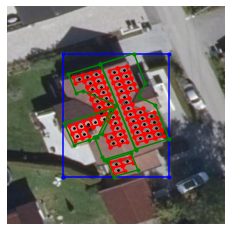

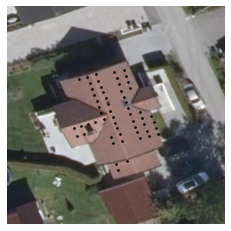

--- 29
Image name: ea56bbcd-6fcd-4832-b61d-71308376ca46


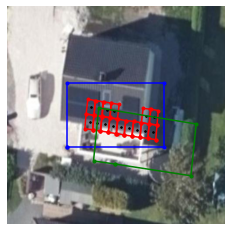

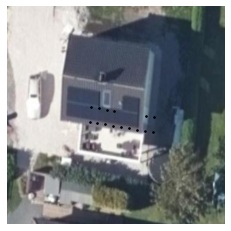

--- 30
Image name: 83f30320-472a-4fbe-946e-5153b2e8772c


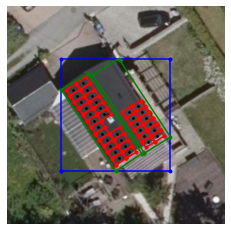

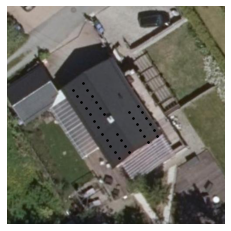

--- 31
Image name: b4105918-0845-41a8-99bb-0d0c14e2b1f6


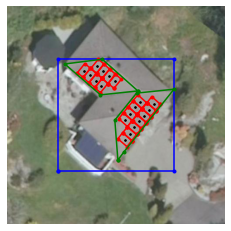

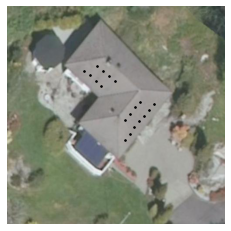

--- 32
Image name: d366e4bb-63ee-44c6-92a1-ce3361c6c15b


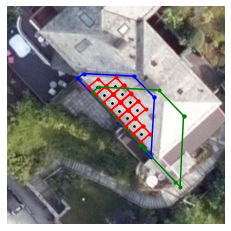

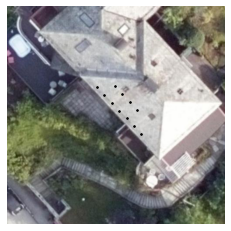

--- 33
Image name: 2e4d7050-4075-4b3a-94ae-0762de918b68


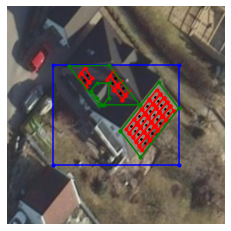

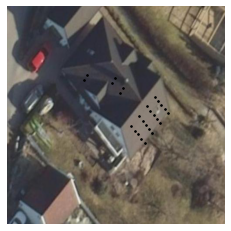

--- 34
Image name: c4c76a08-d38f-4cd7-a252-a1695d3fafca


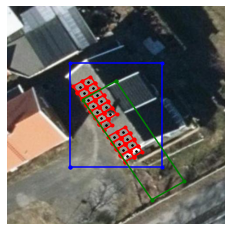

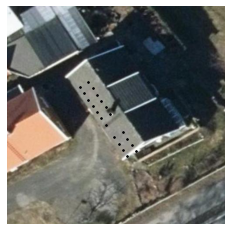

--- 35
Image name: 856a5a14-9b91-4d74-9aa3-2a5d926abda3


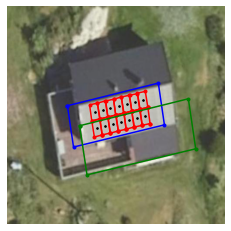

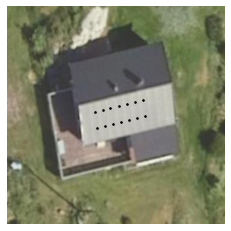

--- 36
Image name: 3ee84f40-2d39-4238-9ac4-2b2f2425ec94


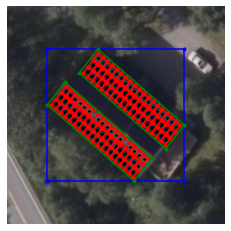

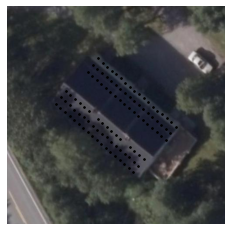

--- 37
Image name: 22fcbfda-7f2a-4c59-80f1-176fe0868f4b


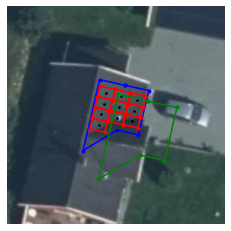

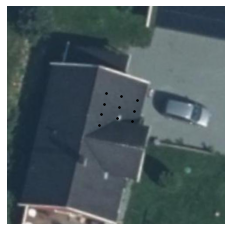

--- 38
Image name: 743d0eb7-eac3-45cd-a254-455cc7935ee5


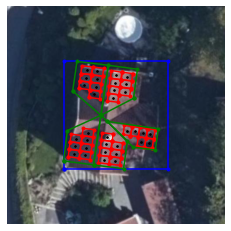

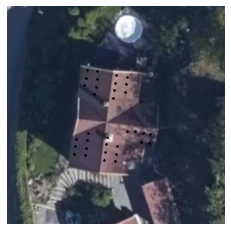

--- 39
Image name: f4c3004e-78dc-4174-9ebe-5f9048c10b54


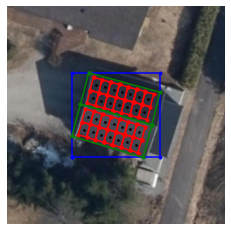

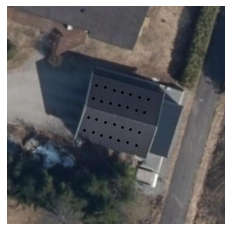

--- 40
Image name: 2e898e65-a74b-47dd-a106-93218804ab8d


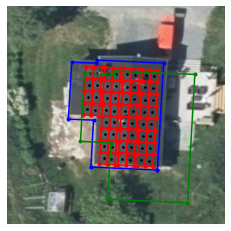

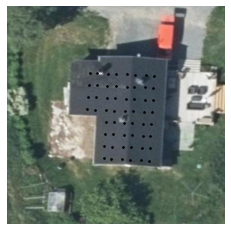

--- 41
Image name: 414e27a5-f499-4963-ad86-bfeb7b9efe6f


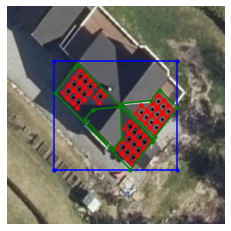

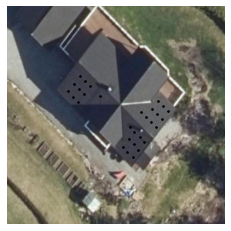

--- 42
Image name: fccd533e-0215-4550-9f59-698d8e45ccea


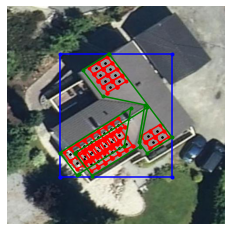

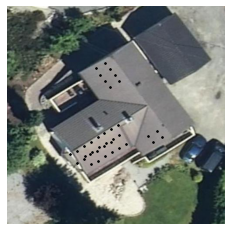

--- 43
Image name: 59846ba8-7d95-4513-ac5a-91522fca44fb


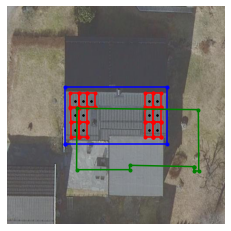

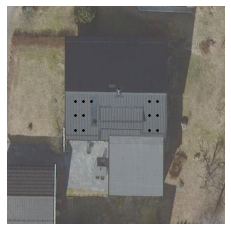

--- 44
Image name: db9767d2-dff3-42a5-ad23-c063d1e85af9


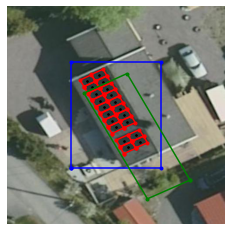

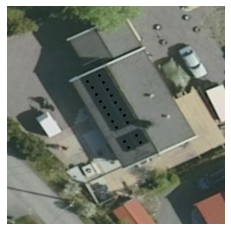

--- 45
Image name: 869965ee-59f4-47da-87cf-7036a44d35a1


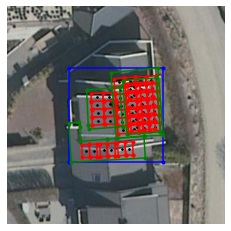

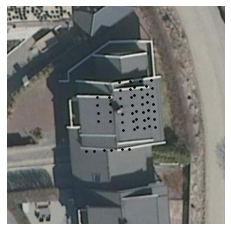

--- 46
Image name: 0c4d2535-795c-4464-9ddb-831209ab4266


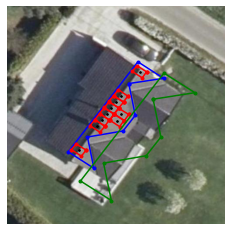

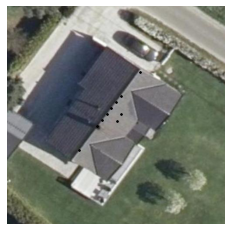

--- 47
Image name: 72a128c0-d2a9-4022-935d-ae177eaca9fd


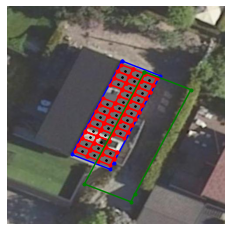

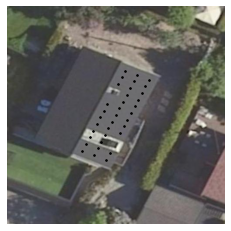

--- 48
Image name: 9debee61-c7d8-41f3-8595-1f085857f3b4


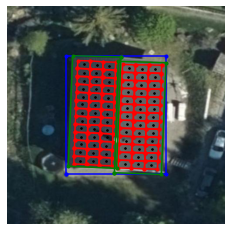

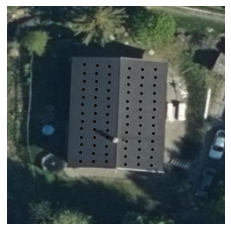

--- 49
Image name: 7f22433f-70ad-43c7-b093-b04857ab2553


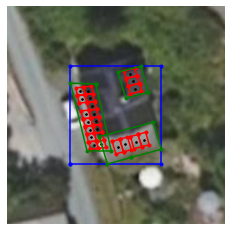

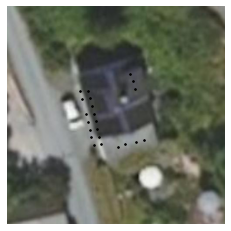

--- 50
Image name: 262f05bd-3a68-4c84-b649-cc0562dd37ee


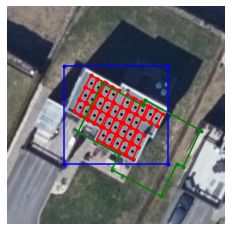

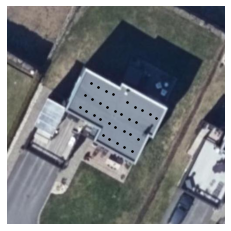

--- 51
Image name: 62b31440-dd52-4a03-a260-1e0029aa7115


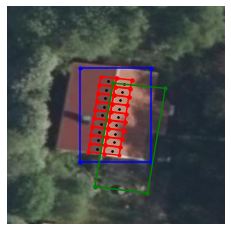

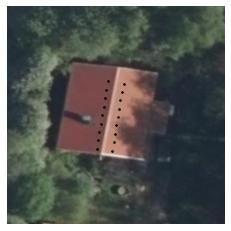

--- 52
Image name: 1f04d152-fb0c-46fd-b3ac-1fd10ca9d9b3


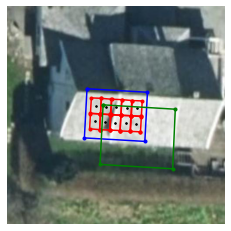

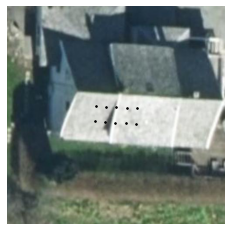

--- 53
Image name: e2cc48d4-7dbc-4a80-96a9-101fc61771cc


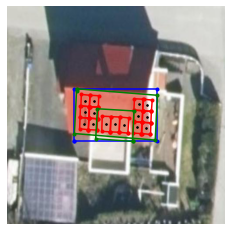

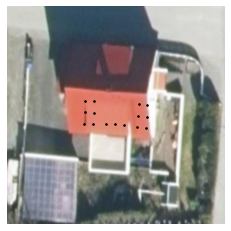

--- 54
Image name: 4fb661ce-1d2c-45a5-8348-aab71c51838f


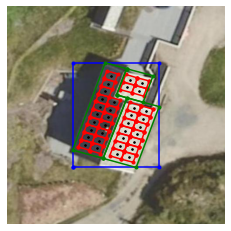

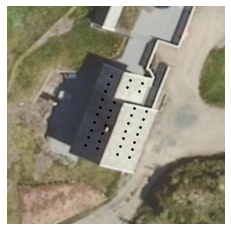

--- 55
Image name: ec1573be-625e-458f-9449-988ea544c060


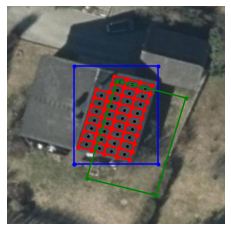

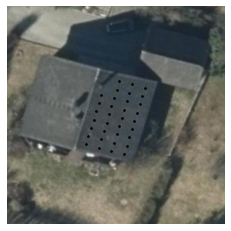

--- 56
Image name: b90a08c6-ba4e-45f7-bdc9-89023ddfbb47


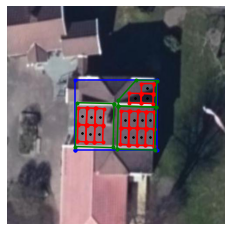

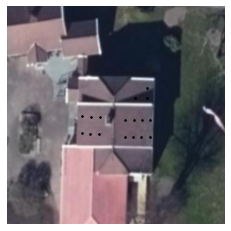

--- 57
Image name: 3859386b-efbc-41e7-9eaf-b396f1bf6d8a


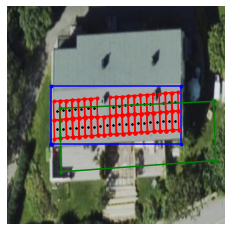

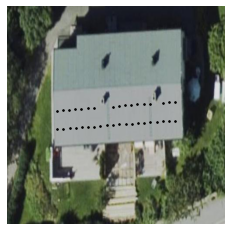

--- 58
Image name: 84d49636-9a57-4030-8493-7115eac3611e


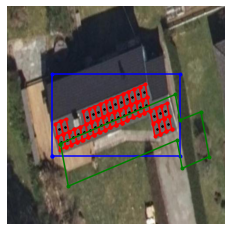

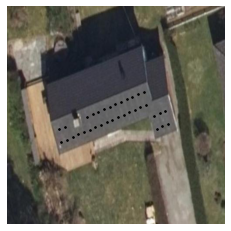

--- 59
Image name: 359097de-fd19-486b-b96c-4b77678915bc


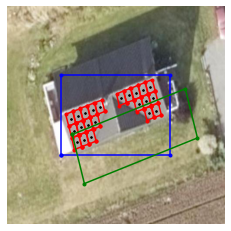

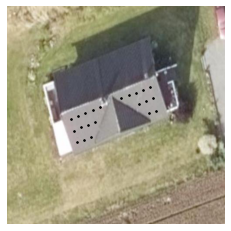

--- 60
Image name: 9dbc2c32-e436-467e-a259-9f13786fde06


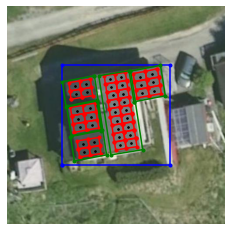

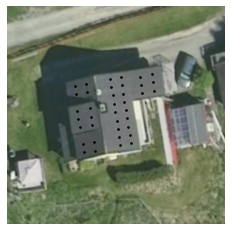

--- 61
Image name: 7f0ffd33-f116-4e25-bee4-489567a31ee0


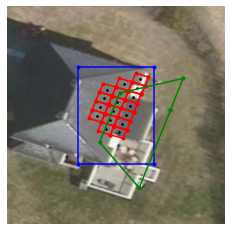

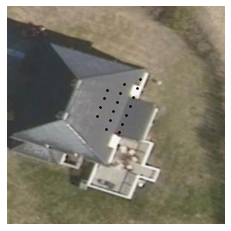

--- 62
Image name: 01d1afcd-d939-46a3-b7f5-55ce6dd8d103


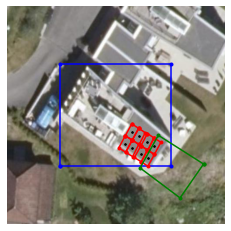

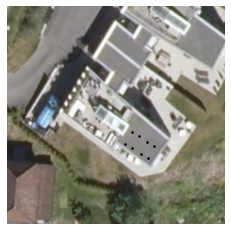

--- 63
Image name: 7f1a1723-4c2a-4895-93ac-e0de2fb3d61e


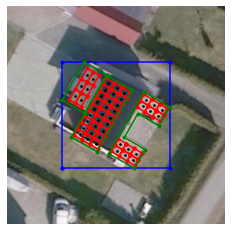

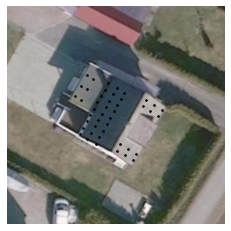

--- 64
Image name: 5bef7099-2e81-48d3-82bc-176cba1e8e11


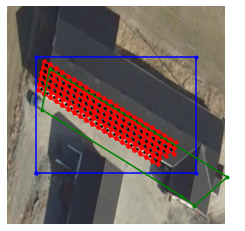

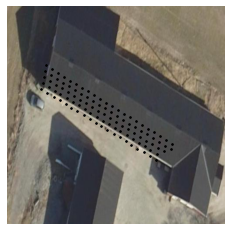

--- 65
Image name: 14e6bf9f-32c8-4e2c-8889-a76f8eec2f52


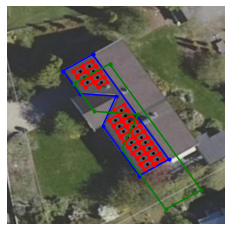

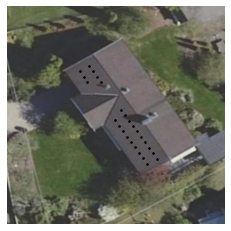

--- 66
Image name: d5654500-7b04-4d4c-9888-3fd7295ebb02


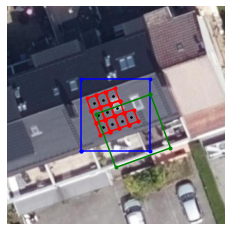

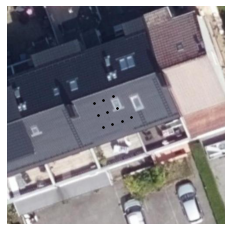

--- 67
Image name: aadd7a7c-2264-4f04-ad31-9978ccaacc66


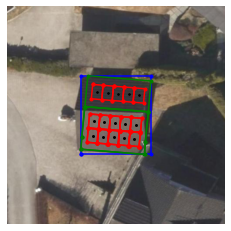

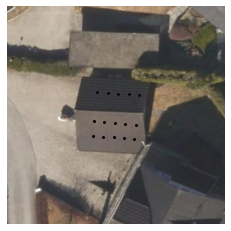

--- 68
Image name: eef9090b-afdc-4325-b1be-96f3f28f0b68


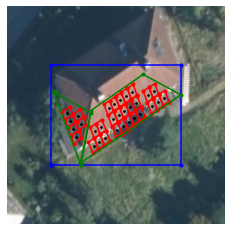

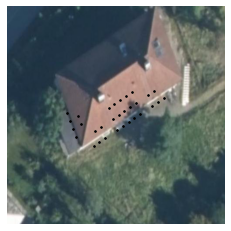

--- 69
Image name: 0ea10342-cd1e-4276-8b74-1d656b9d0352


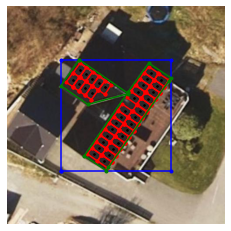

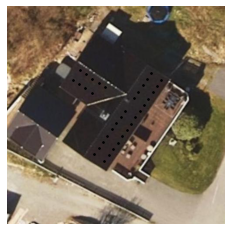

--- 70
Image name: 3dc5d3f1-026f-4d95-82ad-1124b8db6f97


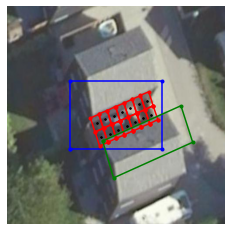

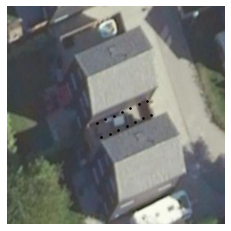

--- 71
Image name: 311e8044-a397-4530-a62d-2f4dbced8a8e


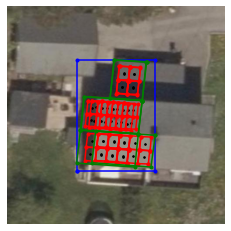

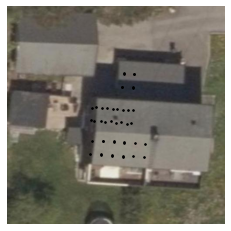

--- 72
Image name: 3f4361f3-400b-46fa-b3f6-bf23a7de56d5


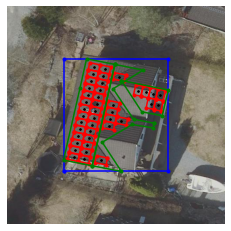

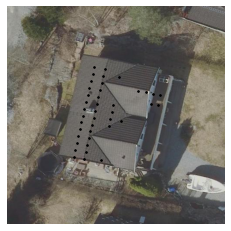

--- 73
Image name: 778a2901-1e42-40b8-94af-bb615dd50537


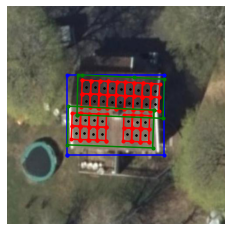

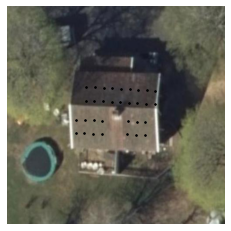

--- 74
Image name: ecd1e6dc-8962-455c-9aec-3646438b6c12


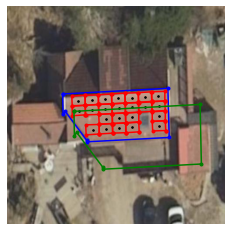

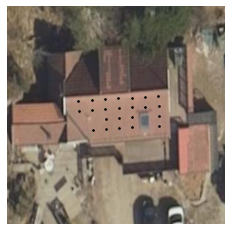

--- 75
Image name: 753df5de-6d64-4c81-a460-8e67f0261fc1


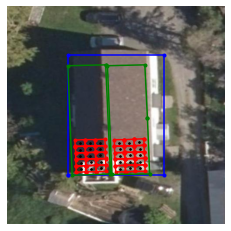

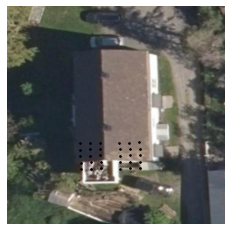

--- 76
Image name: f50171f9-46a1-429c-ac52-2fe96f208eeb


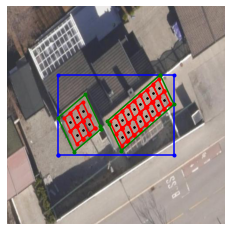

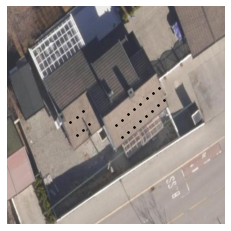

--- 77
Image name: d2730572-856c-4a1f-83aa-7206269cf682


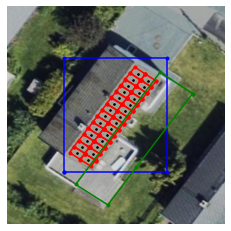

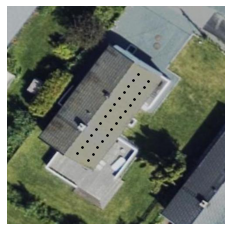

--- 78
Image name: 5a38d0fd-e15b-4c5a-bd4a-d20284055d2d


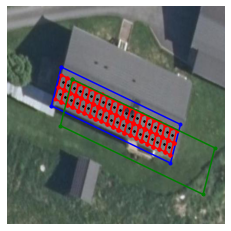

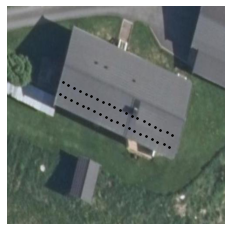

--- 79
Image name: 012f1988-d8c7-4704-af42-4c063a07054e


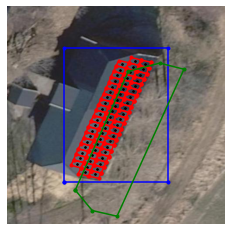

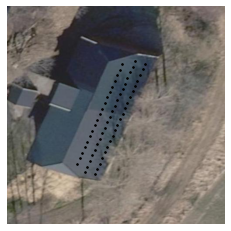

--- 80
Image name: 5fd5ee43-18a3-4feb-ae38-ac8a70489651


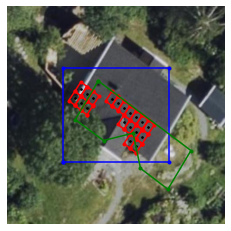

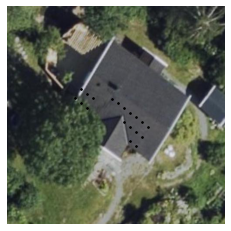

--- 81
Image name: 5d58a461-b588-4823-beab-e8db5462a73f


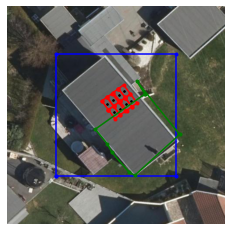

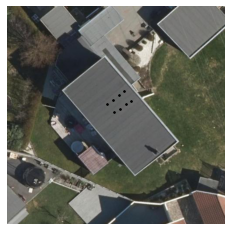

--- 82
Image name: bfb611c1-433e-4af1-89c8-94016c180eae


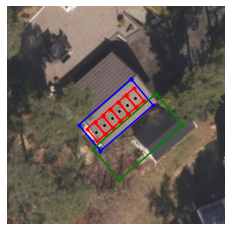

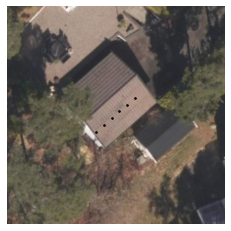

--- 83
Image name: 05b52d2d-1c5f-4ba1-aed4-f3fd966e0962


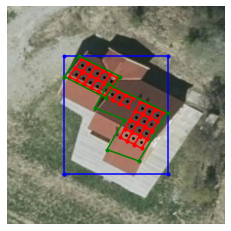

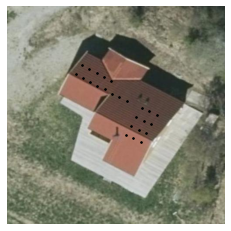

--- 84
Image name: cf9482a0-4076-4923-b838-f88ccedbcf49


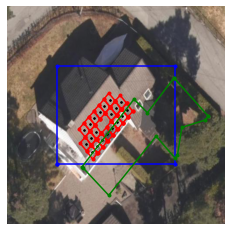

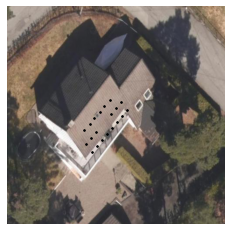

--- 85
Image name: d7cc0506-40a1-466f-80d9-9f8d51c0bc9e


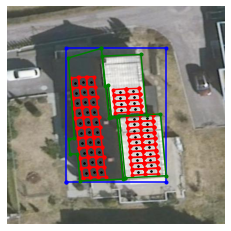

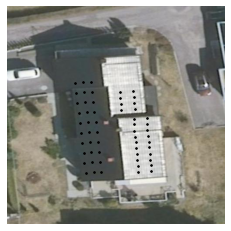

--- 86
Image name: 7133c85e-10de-4d96-90b0-b9ade669f839


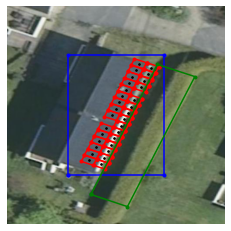

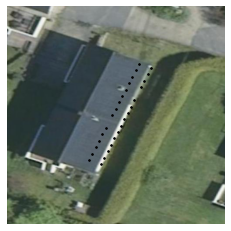

--- 87
Image name: 93258a4a-4fc1-4861-b26b-e62ac95a4100


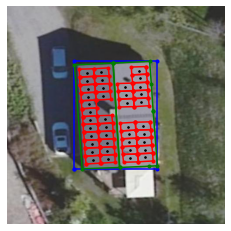

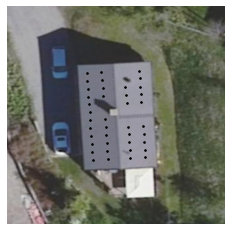

--- 88
Image name: 5a11c591-8110-4e53-a26c-848c999e5e2d


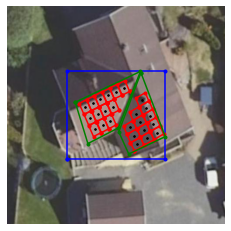

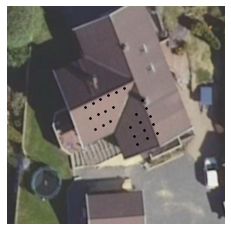

--- 89
Image name: 5fbd690c-ae0c-482d-ac32-0103d35b5d2f


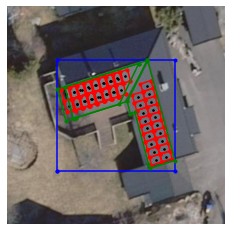

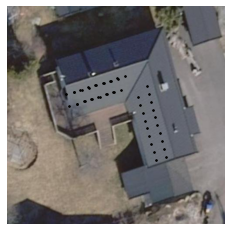

--- 90
Image name: 3e0c1f77-cf4e-4a15-b80d-c6080baad2d1


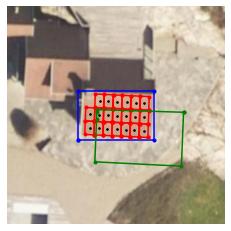

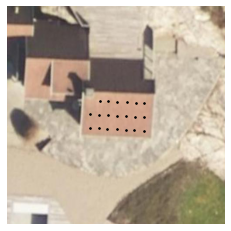

--- 91
Image name: 3891a120-0796-489c-9352-62c76f0c97ef


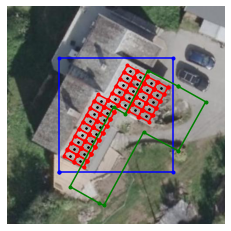

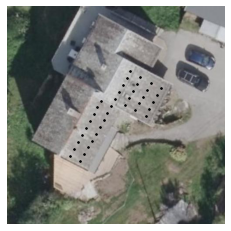

--- 92
Image name: 72653bf2-c5bb-43da-8c7e-515d5da30a75


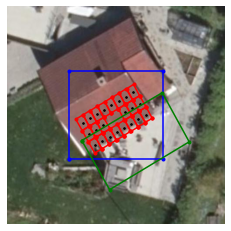

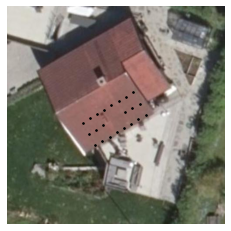

--- 93
Image name: abd0f095-f84f-4797-b7e2-d5e92fff1ac7


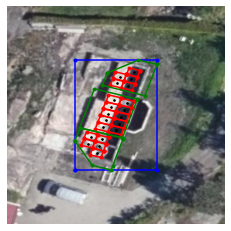

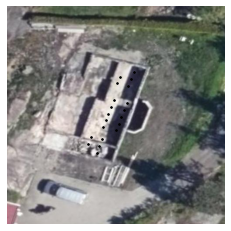

--- 94
Image name: 349d5eb4-8c41-4953-84e2-32a98769a5b9


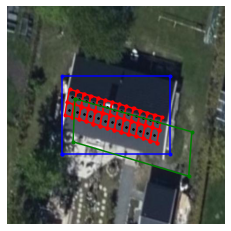

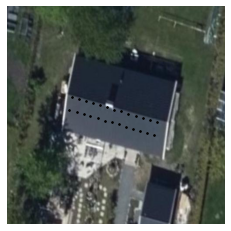

--- 95
Image name: 410de536-b389-481d-a893-12b6ae7fd9e1


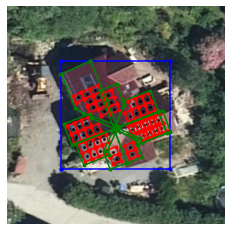

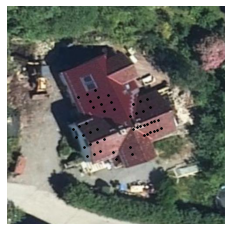

--- 96
Image name: 5a868e68-edd9-4d4c-8fb8-1d30b56c0f49


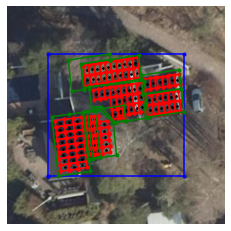

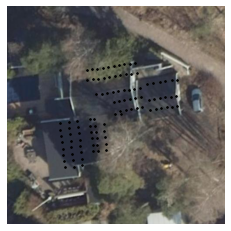

--- 97
Image name: b33e39fb-e42e-4cd6-a18b-0359f7d9fc9d


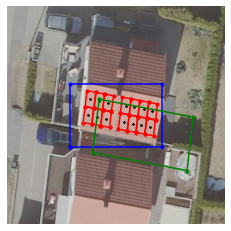

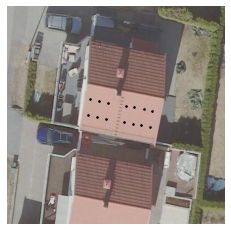

--- 98
Image name: 2d5c5e72-bf4a-4e02-8768-5dd987583398


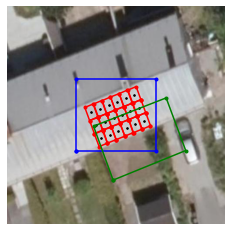

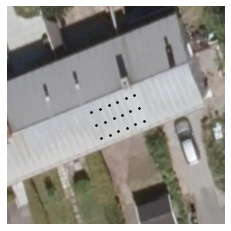

--- 99
Image name: 21fbbc8b-57c5-4c69-bfac-ffc739935e24


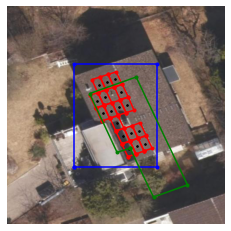

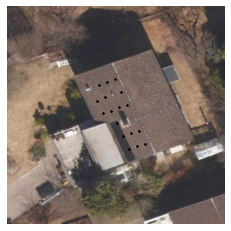

In [161]:
num = 0
for i in list_names:
    print("---",num)
    plot_from_id(i)
    num += 1